<a href="https://colab.research.google.com/github/ronitagarwala01/NASA_GCN_NLP/blob/main/GCN_Topic_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Topic Modelling Pipeline for the NASA GCN Platform**
The aim of this project is to leverage the power of BERTopic to build a transformer powered topic model for the NASA GCN circular database.

It is recommended to run this notebook in Google Colab. Please not that before running this notebook you will need to set up a free HuggingFace account and create an access token to pull down models from Huggingface. More info can be found here: https://huggingface.co/docs/hub/en/security-tokens. Store your token in Google Colab's Secrets as HF_LOGIN_TOKEN and turn on notebook access. More info found here: https://drlee.io/how-to-use-secrets-in-google-colab-for-api-key-protection-a-guide-for-openai-huggingface-and-c1ec9e1277e0.

To get results consistent with those reported in the paper, it is recommended to run each section in this notebook sequentially and only once. Re-running it without restarting the runtime may yield slightly different results in certain sections due to the inherently stochastic nature of some of the agorithms used. We also recommend using Google Colab's L4 GPU runtime, which is what we used in our work. This is not a requirement and any GPU runtime may suffice, however using a different runtime may once again produce minor deviations from the results in our paper, as variations in hardware configurations can affect the outcomes of some of the algorithms used. Using the L4 GPU, however, may require the purchase of a temporary subscription to Colab Pro for $10.

#STEP 1: Install necessary libraries

In [1]:
!wget https://github.com/ronitagarwala01/NASA_GCN_NLP/raw/main/data/archive.json.tar.gz -O /content/archive.json.tar.gz
!wget https://raw.githubusercontent.com/ronitagarwala01/NASA_GCN_NLP/main/data/custom_stopwords.txt -O /content/custom_stopwords.txt

--2024-08-28 18:41:01--  https://github.com/ronitagarwala01/NASA_GCN_NLP/raw/main/data/archive.json.tar.gz
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/ronitagarwala01/NASA_GCN_NLP/main/data/archive.json.tar.gz [following]
--2024-08-28 18:41:02--  https://raw.githubusercontent.com/ronitagarwala01/NASA_GCN_NLP/main/data/archive.json.tar.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 23050043 (22M) [application/octet-stream]
Saving to: ‘/content/archive.json.tar.gz’

/content/archive.js 100%[===================>]  21.98M  --.-KB/s    in 0.1s    

2024-08-28 18:41:02 (231 MB/s) - ‘/content/a

In [2]:
%pip install bertopic==0.16.2 -qqq
%pip install huggingface_hub==0.23.1 -qqq
%pip install safetensors==0.4.3 -qqq
%pip install accelerate==0.30.1 -qqq
%pip install sentence-transformers==2.2.2 -qqq
%pip install peft==0.7.1 -qqq
%pip install -U plotly==5.19.0 -qqq
!CMAKE_ARGS="-DLLAMA_CUBLAS=on" FORCE_CMAKE=1 pip install llama-cpp-python==0.2.76 -qqq
!wget https://huggingface.co/TheBloke/Mistral-7B-Instruct-v0.2-GGUF/resolve/main/mistral-7b-instruct-v0.2.Q4_K_M.gguf

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.8/158.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 67.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.1/227.1 kB 20.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 401.3/401.3 kB 8.7 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
transformers 4.42.4 requires huggingface-hub<1.0,>=0.23.2, but you have huggingface-hub 0.23.1 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 18.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dep

#Step 2: Import Libraries

In [3]:
import tarfile
import os
import json
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
import string
import re
from sklearn.feature_extraction.text import CountVectorizer
from sentence_transformers import SentenceTransformer
import torch
import accelerate
from torch import Tensor
from transformers import AutoTokenizer, AutoModel, pipeline
from tqdm import tqdm
from bertopic import BERTopic
from umap import UMAP
from hdbscan import HDBSCAN
from sklearn.manifold import TSNE
import plotly.graph_objects as go
import plotly.express as px
import itertools
import pandas as pd
from llama_cpp import Llama
from bertopic.representation import LlamaCPP
from bertopic.representation import BaseRepresentation
from bertopic.backend import BaseEmbedder
from datetime import datetime
import matplotlib.dates as mdates
from sentence_transformers.readers import InputExample
from sentence_transformers import SentencesDataset, losses
from torch.utils.data import DataLoader
from sklearn.model_selection import train_test_split
import time
from huggingface_hub import login
from google.colab import userdata
import random

# Set number of threads to 1 and set other os environment variables for reproducibility
os.environ['OMP_NUM_THREADS'] = '1'
os.environ['MKL_NUM_THREADS'] = '1'
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'
torch.set_num_threads(1)

seed_value = 42  # Set the random seed
random.seed(seed_value)
np.random.seed(seed_value)
torch.manual_seed(seed_value)
torch.cuda.manual_seed_all(seed_value)
torch.use_deterministic_algorithms(True)

# Huggingface login required to use Mistral 7B Instruct
# Make sure to save your own Huggingface login token in your Notebook's Secrets as 'HF_LOGIN_TOKEN'
login_token = userdata.get('HF_LOGIN_TOKEN')
login(token=login_token)

nltk.download('stopwords') #NLTK package for stopwords list

The token has not been saved to the git credentials helper. Pass `add_to_git_credential=True` in this function directly or `--add-to-git-credential` if using via `huggingface-cli` if you want to set the git credential as well.
Token is valid (permission: read).
Your token has been saved to /root/.cache/huggingface/token
Login successful


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

#Step 3: Extract GCN Circulars

In [4]:
'''
Extract circular JSONs from tar file.
'''

with tarfile.open('./archive.json.tar.gz', 'r') as file:
  file.extractall(path='./all_gcn_circulars')

dir = os.listdir('./all_gcn_circulars/archive.json') #Store all file names as strings in dir

#Add file path to beginning of file names in dir
dir = ['./all_gcn_circulars/archive.json/' + filename for filename in sorted(dir)]

print(f'Number of Circular JSONs: {len(dir)}\n')
print(f'First JSON path is: {dir[0]}')

Number of Circular JSONs: 35470

First JSON path is: ./all_gcn_circulars/archive.json/-1.json


In [5]:
'''
Extract circular bodies from JSON list.
'''

circulars = []
circular_bodies = []
time_stamps = []
for file in dir:
  with open(file, encoding='utf-8') as f:
    data = json.load(f)
    circulars.append(data)
    circular_bodies.append(data["subject"]+data["body"])
    time_stamps.append(data["createdOn"])

print(f'The first circular is:\n {circulars[0]}\n')
print(f'The first circular body is:\n {circular_bodies[0]}')

The first circular is:
 {'subject': 'Untitled', 'createdOn': 0, 'submitter': 'circulars@gcn.nasa.gov', 'circularId': -1, 'email': 'circulars@gcn.nasa.gov', 'body': '#-01\n\nThe following report from A. Hendon et al. on the recent "possible new SGR"\n(ref IAUC 6743) has also been submitted to the IAUC:\n\n\nA. Henden, Universities Space Research Corporation (USRA) and U. S. Naval\nObservatory, Flagstaff Station (USNOFS)  aah@nofs.navy.mil\nC. Luginbuhl, USNOFS  cbl@nofs.navy.mil\nF. Vrba, USNOFS       fjv@nofs.navy.mil\nB. Canzian, USRA/USNOFS  bjc@nofs.navy.mil\nJ. Munn USNOFS           jam@nofs.navy.mil\nD. Hartmann, Clemson University  hartmann@grb.phys.clemson.edu\n\nWe report a strong near-IR source about 2 arcmin from the the center\nof the IPN error box for GRB970912 (IAUC 6743), located at RA = 18:14:50.31,\nDEC = -13:41:05.6 (J2000, +-0.5arcsec).  JHK images saturate in our shortest\navailable exposure (0.16 sec), but we estimate approximate magnitudes\nof J = 7.4, H = 6.0, K =

In [6]:
'''
Remove all undefined characters.
'''

clean_texts = []
for text in circular_bodies:
  clean_text = text.replace('�', '')
  clean_texts.append(clean_text)

circular_bodies = clean_texts

#Step 4: Create Custom Stopwords List

In [7]:
'''
We will remove common English stopwords, punctuations, numbers, emails, and urls from our topic representations.
We will also remove a hand-selected list of stopwords that do not add any value to our representations.
As BERT uses a transformer based embedding model, it requires stopwords to build accurate embeddings.
So removing stopwords before this step is unadvised.
However, we can remove stopwords after embedding and clustering.
We will use sklearn's WordVectorizer for this.
'''

new_stop_words = []
new_stop_words = stopwords.words('english') #NLTK standard list of stopwords
punctuation_list = list(string.punctuation) #Standard list of punctuations
new_stop_words.extend(punctuation_list)

# Get list of numbers and urls in circulars
num_list = []
url_list = []
http_regex = re.compile(r"http.*")

for text in circular_bodies:
  word_list = text.split()

  for word in word_list:
    try:
      float(word) # Check if word is numeric. Throws Value Error otherwise
      num_list.append(word)
    except ValueError:
      pass

    if re.match(http_regex, word): # Check if word begins with http
      url_list.append(word)

# Get list of emails
email_list=[]
for circular in circulars:
  if "email" in circular:
    email_list.append(circular["email"])

num_list = list(set(num_list)) # Remove duplicates
new_stop_words.extend(num_list)

url_list = list(set(url_list))
new_stop_words.extend(url_list)

email_list = list(set(email_list))
new_stop_words.extend(email_list)

with open('custom_stopwords.txt') as f:
  for word in f:
    new_stop_words.append(word.lower().strip())

vectorizer_model = CountVectorizer(stop_words=new_stop_words)

#Step 5: Get some Prelminary Statistics

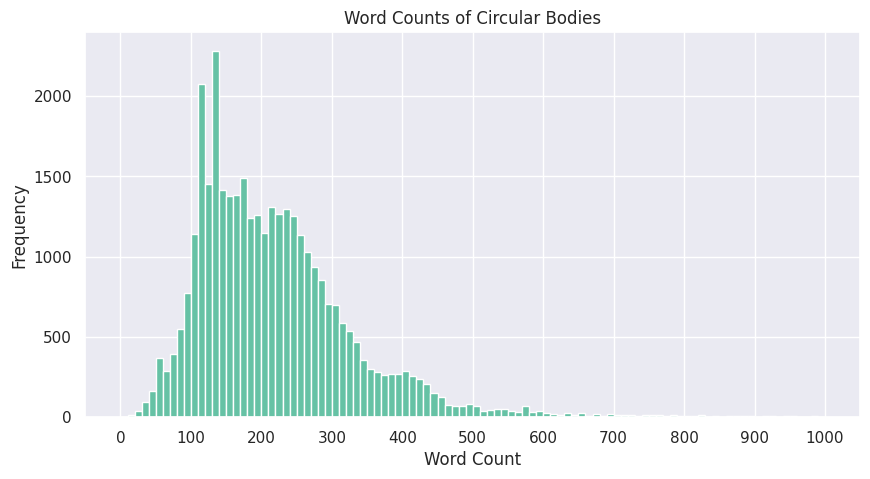

Number of circulars with > 1000 words: 242


In [8]:
'''
Get word count distribution over all circulars.
'''
sns.set_theme()

counts=[]
for text in circular_bodies:
  counts.append(len(text.split()))

plt.figure(figsize=(10, 5))
plt.hist(counts, range=(0,1000), bins=100, color=sns.color_palette("Set2", 1))
plt.xlabel("Word Count")
plt.ylabel("Frequency")
plt.title("Word Counts of Circular Bodies")
plt.xticks(np.arange(0, 1001, 100))
plt.show()

counts_over_1000 = [count>1000 for count in counts]
print(f'Number of circulars with > 1000 words: {sum(counts_over_1000)}')

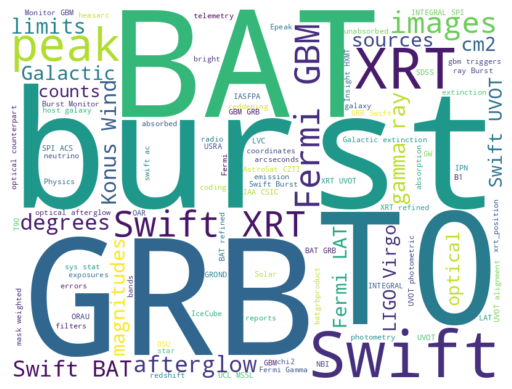

In [9]:
'''
Create word cloud over all GCN circulars.
Includes bigrams and trigrams of words.
'''

word_cloud = WordCloud(
    collocations = True,
    background_color = 'white',
    max_words=100,
    width=800,
    height=600,
    stopwords=new_stop_words).generate(' '.join(circular_bodies))

plt.imshow(word_cloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [10]:
'''
Print the list of words in the word cloud
'''

word_frequencies = word_cloud.words_
words = list(word_frequencies.keys())
for word in words:
  print(word)

burst
GRB
T0
BAT
Swift
XRT
peak
Swift XRT
Fermi GBM
images
afterglow
Swift BAT
degrees
Konus Wind
gamma ray
limits
magnitudes
cm2
Galactic
sources
Fermi LAT
Swift UVOT
LIGO Virgo
optical
counts
optical afterglow
T90
photometry
ray Burst
swift ac
exposures
emission
Burst Monitor
UVOT
GBM
errors
star
arcseconds
Fermi
redshift
reports
Fermi Gamma
IceCube
heasarc
B1
Galactic extinction
Solar
bright
gbm triggers
extinction
unabsorbed
coordinates
IASFPA
IAA CSIC
Swift Burst
SPI ACS
USRA
bands
Epeak
SDSS
absorption
IPN
Physics
host galaxy
INTEGRAL SPI
Monitor GBM
telemetry
reddening
chi2
coding
BAT refined
optical counterpart
GROND
BAT GRB
GW
sys stat
INTEGRAL
UCL MSSL
galaxy
AstroSat CZTI
NBI
radio
mask weighted
GRB Swift
OAR
GBM GRB
absorbed
filters
ORAU
XRT refined
Insight HXMT
batgrbproduct
LVC
UVOT photometric
XRT UVOT
OSU
UVOT alignment
neutrino
LAT
xrt_position


#Step 6: Embed our Circulars

In [11]:
'''
Embed our circulars using the base all-MiniLM-L6-v2 model.
'''

# Default model. Really fast, but only has context window of 256 tokens
model = SentenceTransformer("all-MiniLM-L6-v2")
minilm_l6_embeddings = model.encode(circular_bodies, show_progress_bar=True)
np.save('minilm_l6_embeddings.npy', minilm_l6_embeddings)

.gitattributes:   0%|          | 0.00/1.23k [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

data_config.json:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

model.onnx:   0%|          | 0.00/90.4M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

train_script.py:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

Batches:   0%|          | 0/1109 [00:00<?, ?it/s]

#Step 7: Embedding Model Evaluation with Zero-Shot Topic Modelling

In [ ]:
'''
We will now test our topic models on a small pre-defined dataset.
We have gathered GCN circulars belonging to the following categories:
  -High-Energy Observations
  -Optical Observations
  -Radio
  -Neutrino
  -Gravitational Wave
In total we have 72 circulars in our dataset.
Our goal is to find the topic model that can correctly classify most of these circulars based on Zero-Shot Classification.
'''

# Prepare dataset
high_energy = [25672, 26248, 14327, 14131, 6000, 29383, 17260, 10699, 19545, 17866, 9117, 8860, 6212, 26146, 7009, 7744, 10283, 22271, 2462, 28289, 25300, 24996, 3348, 26573, 11527, 20928, 29800, 28011, 12555, 32813, 23226, 33757, 2505, 23140, 13558, 12449, 23445, 22699, 13959, 22115]
optical = [28681, 22275, 21480, 3791, 5286, 2192, 31976, 23411, 18503, 23516, 31426, 31356, 33293, 17415, 31015, 598, 4738, 9761, 17736, 9628, 28161, 13557, 34651, 5615, 5065, 11329, 19277, 30221, 21931, 13710, 28226, 9179, 24256, 31394, 33941, 33098, 34473, 29604, 30112, 3199]
radio = [9047, 13903, 30542, 23753, 21933, 21395, 20787, 19610, 18548, 18345, 21058, 21057, 20981, 20105, 20453, 20313, 20344, 20328, 18978, 19310, 19607, 19848, 20116, 19606, 18454, 19966, 18620, 20428, 17178, 17284, 17104, 16593, 15783, 14863, 13813, 13743, 16603, 16295, 15395, 10019]
neutrino = [23605, 34933, 34838, 34798, 34163, 34166, 33876, 33589, 33430, 33850, 33128, 33122, 33097, 33040, 32741, 32523, 32499, 31681, 30468, 31128, 31476, 26718, 27642, 26812, 26716, 26707, 26623, 26620, 26189, 26181, 26049, 25836, 25842, 25693, 25225, 25210, 24865, 24854, 24573, 24410]
gw = [34895, 34857, 34801, 34799, 34775, 34692, 34728, 34605, 34337, 34264, 34206, 34173, 34968, 27358, 27278, 27193, 27042, 26906, 26675, 26543, 26513, 26641, 26413, 26334, 26303, 26288, 26254, 26250, 26182, 25883, 25876, 25871, 25829, 25814, 25707, 25554, 25442, 25324, 25296, 25012]

high_energy_train, high_energy_test = train_test_split(high_energy, test_size=0.2, random_state=0)
optical_train, optical_test = train_test_split(optical, test_size=0.2, random_state=0)
radio_train, radio_test = train_test_split(radio, test_size=0.2, random_state=0)
neutrino_train, neutrino_test = train_test_split(neutrino, test_size=0.2, random_state=0)
gw_train, gw_test = train_test_split(gw, test_size=0.2, random_state=0)

train_observation_labels = []
test_observation_labels = []

# Get Training Set
for circular in circulars:
  if circular["circularId"] in high_energy_train:
    train_observation_labels.append("High Energy Observations")
  elif circular["circularId"] in optical_train:
    train_observation_labels.append("Optical Observations")
  elif circular["circularId"] in radio_train:
    train_observation_labels.append("Radio Observations")
  elif circular["circularId"] in neutrino_train:
    train_observation_labels.append("Neutrinos")
  elif circular["circularId"] in gw_train:
    train_observation_labels.append("Gravitational Wave")
  else:
    train_observation_labels.append("")

# Get Test Set
for circular in circulars:
  if circular["circularId"] in high_energy_test:
    test_observation_labels.append("High Energy Observations")
  elif circular["circularId"] in optical_test:
    test_observation_labels.append("Optical Observations")
  elif circular["circularId"] in radio_test:
    test_observation_labels.append("Radio Observations")
  elif circular["circularId"] in neutrino_test:
    test_observation_labels.append("Neutrinos")
  elif circular["circularId"] in gw_test:
    test_observation_labels.append("Gravitational Wave")
  else:
    test_observation_labels.append("")

print(len(train_observation_labels))
print(len(test_observation_labels))
print(len(high_energy_train))
print(len(high_energy_test))
print(len(optical_train))
print(len(optical_test))
print(len(radio_train))
print(len(radio_test))
print(len(neutrino_train))
print(len(neutrino_test))
print(len(gw_train))
print(len(gw_test))

35470
35470
32
8
32
8
32
8
32
8
32
8


In [ ]:
'''
We will perform Zero-Shot Topic Modelling to match circulars to pre-defined cadidate labels.
We'll be using a cosine similarity with various thresholds to match topic labels to circulars.
For the circulars that don't match any of the labels above our threshold we perform regular Topic Modelling.
Finally, we calculate accuracy scores for each embedding model and cosine threshold based on our dataset.
'''

embeddings_list = ["Base Model", "Epoch 1", "Epoch 2", "Epoch 3"]
accuracy_scores = pd.DataFrame(index=["Train", "Test"], columns=embeddings_list)

umap_model = UMAP(n_neighbors=15,
                  n_components=5,
                  min_dist=0.0,
                  metric='cosine',
                  low_memory=False,
                  random_state=0)

candidate_topics = ["High Energy Observations",
                    "Optical Observations",
                    "Radio Observations",
                    "Neutrinos",
                    "Gravitational Wave"]

In [ ]:
'''
Compute accuracy for all-MiniLM-L6-v2 embeddings on training set
'''

embeddings = np.load("minilm_l6_embeddings.npy")
model = SentenceTransformer("all-MiniLM-L6-v2")
error_count=0

# Compute accuracy scores based on number of matches between candidate labels and topic model labels
topic_model = BERTopic(verbose=True,
                       umap_model=umap_model,
                       vectorizer_model=vectorizer_model,
                       zeroshot_topic_list=candidate_topics,
                       zeroshot_min_similarity=0.0,
                       embedding_model=model)

topics, probs = topic_model.fit_transform(circular_bodies, embeddings)

topic_labels=[]
for topic in topics:
  topic_labels.append(topic_model.topic_labels_[topic])

score = 0
for i, label in enumerate(train_observation_labels):
  if label != "":
    if topic_labels[i] == label:
      score += 1
    else:
      error_count += 1

print(f"Raw Score: {score}")
print(f"Raw Error: {error_count}")
accuracy = (score / (score + error_count)) * 100
accuracy_scores.at["Train", "Base Model"] = accuracy

2024-06-05 20:00:14,491 - BERTopic - Zeroshot Step 1 - Finding documents that could be assigned to either one of the zero-shot topics
2024-06-05 20:00:14,922 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:00:14,938 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:00:14,941 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:00:15,014 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:00:15,028 - BERTopic - Cluster - Completed ✓
2024-06-05 20:00:15,038 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:00:21,206 - BERTopic - Representation - Completed ✓
2024-06-05 20:00:21,653 - BERTopic - Zeroshot Step 2 - Completed ✓
2024-06-05 20:00:21,654 - BERTopic - Zeroshot Step 3 - Combining clustered topics with the zeroshot model


Raw Score: 107
Raw Error: 53


In [ ]:
'''
Compute accuracy scores for base model on test set
'''

error_count=0

topic_model = BERTopic(verbose=True,
                      umap_model=umap_model,
                      vectorizer_model=vectorizer_model,
                      zeroshot_topic_list=candidate_topics,
                      zeroshot_min_similarity=0.0,
                      embedding_model=model)

topics, probs = topic_model.fit_transform(circular_bodies, embeddings)

topic_labels=[]
for topic in topics:
  topic_labels.append(topic_model.topic_labels_[topic])

score = 0
for i, label in enumerate(test_observation_labels):
  if label != "":
    if topic_labels[i] == label:
      score += 1
    else:
      error_count += 1

print(f"Raw Score: {score}")
print(f"Raw Error: {error_count}")
accuracy = (score / (score + error_count)) * 100
accuracy_scores.at["Test", "Base Model"] = accuracy

2024-06-05 20:00:21,708 - BERTopic - Zeroshot Step 1 - Finding documents that could be assigned to either one of the zero-shot topics
2024-06-05 20:00:22,036 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:00:22,055 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:00:22,058 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:00:22,123 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:00:22,137 - BERTopic - Cluster - Completed ✓
2024-06-05 20:00:22,146 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:00:28,110 - BERTopic - Representation - Completed ✓
2024-06-05 20:00:28,562 - BERTopic - Zeroshot Step 2 - Completed ✓
2024-06-05 20:00:28,563 - BERTopic - Zeroshot Step 3 - Combining clustered topics with the zeroshot model


Raw Score: 26
Raw Error: 14


In [ ]:
accuracy_scores

,Base Model,Epoch 1,Epoch 2,Epoch 3
Train,66.875,NaN,NaN,NaN
Test,65.0,NaN,NaN,NaN


We can see that the all-MiniLM-L6-v2 achieves an accuracy of 66.875% and 65% on the train and test set respectively straight out of the box. Let us now see if further fine-tuning can help further improve our clustering accuracy.

#Step 8: Contrastive Fine-Tuning

In [ ]:
'''
We will now fine-tune our sentence embedder model using Contrastive Loss.
The goal is to fine-tune our embeddings so that circulars belong to similar topics are embedded more closely,
while circulars belonging to dissimilar topics are embedded far away in the vector space.
Theoretically this should help improve our zero-shot topic modelling accuracy.
We'll be using the same event-based circular dataset as before.
'''

# Prepare Dataset
event_dataset = []
for text, label in zip(circular_bodies, train_observation_labels):
  example = {}
  if label != "":
    example["text"] = text
    example["label"] = candidate_topics.index(label)
    event_dataset.append(example)

print(len(event_dataset))
print(event_dataset[0])

160
{'text': 'Radio observation of GRB080916c with ATCAAquib Moin (Curtin Institute of Radio Astronomy / Australia Telescope\nNational Facility), Steven Tingay (Curtin Institute of Radio Astronomy),\nChris Phillips (Australia Telescope National Facility), Gregory Taylor\n(University of New Mexico), Mark Wieringa (Australia Telescope National\nFacility) and Ralph Martin (Perth Observatory) report:\n\nWe observed the XRT position of the GRB080916c (GCN 8261) at 5.5 GHz\nwith the Australia Telescope Compact Array (ATCA) between 14:00:00 UT\nand 20:00:00 UT on July 01, 2009.\n\nWe did not detect a radio source at the XRT position of the GRB080916c\n(GCN 8261). The radio flux density at the afterglow position found out\nto be 0.230 +/- 0.180 mJy/beam (1-sigma). The compact array was in its\nmost compact configuration.\n\nThe Australia Telescope Compact Array (/ Parkes telescope / Mopra\ntelescope / Long Baseline Array) is part of the Australia Telescope\nwhich is funded by the Commonwealth 

In [ ]:
# Prepare Similar Event Dataset
event_pair_dataset = []
for i in event_dataset:
  for j in event_dataset:
    example={}
    example["texts"] = [i["text"], j["text"]]
    if i["label"] == j["label"]:
      example["label"] = 1
    else:
      example["label"] = 0
    event_pair_dataset.append(example)

print(len(event_pair_dataset))
print(event_pair_dataset[0])

25600
{'texts': ['Radio observation of GRB080916c with ATCAAquib Moin (Curtin Institute of Radio Astronomy / Australia Telescope\nNational Facility), Steven Tingay (Curtin Institute of Radio Astronomy),\nChris Phillips (Australia Telescope National Facility), Gregory Taylor\n(University of New Mexico), Mark Wieringa (Australia Telescope National\nFacility) and Ralph Martin (Perth Observatory) report:\n\nWe observed the XRT position of the GRB080916c (GCN 8261) at 5.5 GHz\nwith the Australia Telescope Compact Array (ATCA) between 14:00:00 UT\nand 20:00:00 UT on July 01, 2009.\n\nWe did not detect a radio source at the XRT position of the GRB080916c\n(GCN 8261). The radio flux density at the afterglow position found out\nto be 0.230 +/- 0.180 mJy/beam (1-sigma). The compact array was in its\nmost compact configuration.\n\nThe Australia Telescope Compact Array (/ Parkes telescope / Mopra\ntelescope / Long Baseline Array) is part of the Australia Telescope\nwhich is funded by the Commonwea

In [ ]:
'''
Train for 1 epoch on the training set
'''

# Set seeds to help reproducibility
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'
seed_value = 42
torch.manual_seed(seed_value)
torch.cuda.manual_seed_all(seed_value)
np.random.seed(seed_value)
random.seed(seed_value)
torch.use_deterministic_algorithms(True)

# Prepare Training Examples, Loss, and Model (all-MiniLM-L6-v2)
model = SentenceTransformer("all-MiniLM-L6-v2")
train_examples = [InputExample(texts=example["texts"], label=example["label"]) for example in event_pair_dataset]

# Prepare DataLoader Object
train_dataloader = DataLoader(train_examples,
                              shuffle=True,
                              batch_size=1,
                              num_workers=0)
train_size = len(train_dataloader)

# Use Contrastive Training Loss
train_loss = losses.ContrastiveLoss(model=model)

# Tune the model
model.fit(train_objectives=[(train_dataloader, train_loss)],
          epochs=1,
          warmup_steps=100)

# Save the model
model.save("tuned_mini_lm_1")

Epoch:   0%|          | 0/1 [00:00<?, ?it/s]

Iteration:   0%|          | 0/25600 [00:00<?, ?it/s]

In [ ]:
'''
Train for 2 epochs on the training set
'''

# Set seeds to help reproducibility
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'
seed_value = 42
torch.manual_seed(seed_value)
torch.cuda.manual_seed_all(seed_value)
np.random.seed(seed_value)
random.seed(seed_value)
torch.use_deterministic_algorithms(True)

# Prepare Training Examples, Loss, and Model (all-MiniLM-L6-v2)
model = SentenceTransformer("all-MiniLM-L6-v2")
train_examples = [InputExample(texts=example["texts"], label=example["label"]) for example in event_pair_dataset]

# Prepare DataLoader Object
train_dataloader = DataLoader(train_examples,
                              shuffle=True,
                              batch_size=1,
                              num_workers=0)
train_size = len(train_dataloader)

# Use Contrastive Training Loss
train_loss = losses.ContrastiveLoss(model=model)

# Tune the model
model.fit(train_objectives=[(train_dataloader, train_loss)],
          epochs=2,
          warmup_steps=100)

# Save the model
model.save("tuned_mini_lm_2")

Epoch:   0%|          | 0/2 [00:00<?, ?it/s]

Iteration:   0%|          | 0/25600 [00:00<?, ?it/s]

Iteration:   0%|          | 0/25600 [00:00<?, ?it/s]

In [ ]:
'''
Train for 3 epochs on the training set
'''

# Set seeds to help reproducibility
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'
seed_value = 42
torch.manual_seed(seed_value)
torch.cuda.manual_seed_all(seed_value)
np.random.seed(seed_value)
random.seed(seed_value)
torch.use_deterministic_algorithms(True)

# Prepare Training Examples, Loss, and Model (all-MiniLM-L6-v2)
model = SentenceTransformer("all-MiniLM-L6-v2")
train_examples = [InputExample(texts=example["texts"], label=example["label"]) for example in event_pair_dataset]

# Prepare DataLoader Object
train_dataloader = DataLoader(train_examples,
                              shuffle=True,
                              batch_size=1,
                              num_workers=0)
train_size = len(train_dataloader)

# Use Contrastive Training Loss
train_loss = losses.ContrastiveLoss(model=model)

# Tune the model
model.fit(train_objectives=[(train_dataloader, train_loss)],
          epochs=3,
          warmup_steps=100)

# Save the model
model.save("tuned_mini_lm_3")

Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Iteration:   0%|          | 0/25600 [00:00<?, ?it/s]

Iteration:   0%|          | 0/25600 [00:00<?, ?it/s]

Iteration:   0%|          | 0/25600 [00:00<?, ?it/s]

In [ ]:
# Get new all-MiniLM-L6-v2 embeddings
model_1 = SentenceTransformer("/content/tuned_mini_lm_1")
model_2 = SentenceTransformer("/content/tuned_mini_lm_2")
model_3 = SentenceTransformer("/content/tuned_mini_lm_3")

tuned_embeddings_1 = model_1.encode(circular_bodies, show_progress_bar=True)
tuned_embeddings_2 = model_2.encode(circular_bodies, show_progress_bar=True)
tuned_embeddings_3 = model_3.encode(circular_bodies, show_progress_bar=True)

Batches:   0%|          | 0/1109 [00:00<?, ?it/s]

Batches:   0%|          | 0/1109 [00:00<?, ?it/s]

Batches:   0%|          | 0/1109 [00:00<?, ?it/s]

In [ ]:
'''
Compute training accuracy for fine-tuned all-MiniLM-L6-v2 embeddings
'''

error_count=0

# Compute accuracy scores based on number of matches between candidate labels and topic model labels
for i in range(1,4):
  embeddings = eval(f"tuned_embeddings_{i}")
  model = eval(f"model_{i}")
  topic_model = BERTopic(verbose=True,
                         umap_model=umap_model,
                         vectorizer_model=vectorizer_model,
                         zeroshot_topic_list=candidate_topics,
                         zeroshot_min_similarity=0.0,
                         embedding_model=model)

  topics, probs = topic_model.fit_transform(circular_bodies, embeddings)

  topic_labels=[]
  for topic in topics:
    topic_labels.append(topic_model.topic_labels_[topic])

  score = 0
  error_count = 0
  for j, label in enumerate(train_observation_labels):
    if label != "":
      if topic_labels[j] == label:
        score += 1
      else:
        error_count += 1

  print(f"Raw Score for Epoch {i}: {score}")
  print(f"Raw Error for Epoch {i}: {error_count}")
  accuracy = (score / (score + error_count)) * 100
  epoch = f"Epoch {i}"
  accuracy_scores.at["Train", epoch] = accuracy

2024-06-05 20:02:05,073 - BERTopic - Zeroshot Step 1 - Finding documents that could be assigned to either one of the zero-shot topics
2024-06-05 20:02:05,407 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:02:05,423 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:02:05,426 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:02:05,496 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:02:05,509 - BERTopic - Cluster - Completed ✓
2024-06-05 20:02:05,519 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:02:11,585 - BERTopic - Representation - Completed ✓
2024-06-05 20:02:12,039 - BERTopic - Zeroshot Step 2 - Completed ✓
2024-06-05 20:02:12,040 - BERTopic - Zeroshot Step 3 - Combining clustered topics with the zeroshot model
2024-06-05 20:02:12,077 - BERTopic - Zeroshot Step 1 - Finding documents that

Raw Score for Epoch 1: 128
Raw Error for Epoch 1: 32


2024-06-05 20:02:12,412 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:02:12,428 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:02:12,431 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:02:12,501 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:02:12,516 - BERTopic - Cluster - Completed ✓
2024-06-05 20:02:12,526 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:02:18,589 - BERTopic - Representation - Completed ✓
2024-06-05 20:02:19,004 - BERTopic - Zeroshot Step 2 - Completed ✓
2024-06-05 20:02:19,006 - BERTopic - Zeroshot Step 3 - Combining clustered topics with the zeroshot model
2024-06-05 20:02:19,043 - BERTopic - Zeroshot Step 1 - Finding documents that could be assigned to either one of the zero-shot topics


Raw Score for Epoch 2: 160
Raw Error for Epoch 2: 0


2024-06-05 20:02:19,336 - BERTopic - Zeroshot Step 1 - Completed ✓
2024-06-05 20:02:19,339 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:02:35,258 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:02:35,260 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:02:35,790 - BERTopic - Cluster - Completed ✓
2024-06-05 20:02:35,797 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:02:38,288 - BERTopic - Representation - Completed ✓
2024-06-05 20:02:43,976 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:02:43,988 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:02:43,990 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:02:44,018 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:02:44,027 - BERTopic - Cluster - Completed ✓
2024

Raw Score for Epoch 3: 96
Raw Error for Epoch 3: 64


In [ ]:
'''
Compute test accuracy for fine-tuned all-MiniLM-L6-v2 embeddings
'''

error_count=0

# Compute accuracy scores based on number of matches between candidate labels and topic model labels
for i in range(1,4):
  embeddings = eval(f"tuned_embeddings_{i}")
  model = eval(f"model_{i}")
  topic_model = BERTopic(verbose=True,
                         umap_model=umap_model,
                         vectorizer_model=vectorizer_model,
                         zeroshot_topic_list=candidate_topics,
                         zeroshot_min_similarity=0.0,
                         embedding_model=model)

  topics, probs = topic_model.fit_transform(circular_bodies, embeddings)

  topic_labels=[]
  for topic in topics:
    topic_labels.append(topic_model.topic_labels_[topic])

  score = 0
  error_count = 0
  for j, label in enumerate(test_observation_labels):
    if label != "":
      if topic_labels[j] == label:
        score += 1
      else:
        error_count += 1

  print(f"Raw Score for Epoch {i}: {score}")
  print(f"Raw Error for Epoch {i}: {error_count}")
  accuracy = (score / (score + error_count)) * 100
  epoch = f"Epoch {i}"
  accuracy_scores.at["Test", epoch] = accuracy

2024-06-05 20:05:45,148 - BERTopic - Zeroshot Step 1 - Finding documents that could be assigned to either one of the zero-shot topics
2024-06-05 20:05:45,480 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:05:45,498 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:05:45,500 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:05:45,567 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:05:45,580 - BERTopic - Cluster - Completed ✓
2024-06-05 20:05:45,590 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:05:51,684 - BERTopic - Representation - Completed ✓
2024-06-05 20:05:52,141 - BERTopic - Zeroshot Step 2 - Completed ✓
2024-06-05 20:05:52,142 - BERTopic - Zeroshot Step 3 - Combining clustered topics with the zeroshot model
2024-06-05 20:05:52,177 - BERTopic - Zeroshot Step 1 - Finding documents that

Raw Score for Epoch 1: 31
Raw Error for Epoch 1: 9


2024-06-05 20:05:52,518 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:05:52,535 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:05:52,538 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:05:52,600 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:05:52,614 - BERTopic - Cluster - Completed ✓
2024-06-05 20:05:52,624 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:05:58,721 - BERTopic - Representation - Completed ✓
2024-06-05 20:05:59,145 - BERTopic - Zeroshot Step 2 - Completed ✓
2024-06-05 20:05:59,146 - BERTopic - Zeroshot Step 3 - Combining clustered topics with the zeroshot model
2024-06-05 20:05:59,182 - BERTopic - Zeroshot Step 1 - Finding documents that could be assigned to either one of the zero-shot topics


Raw Score for Epoch 2: 36
Raw Error for Epoch 2: 4


2024-06-05 20:05:59,477 - BERTopic - Zeroshot Step 1 - Completed ✓
2024-06-05 20:05:59,480 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:06:15,292 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:06:15,294 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:06:15,828 - BERTopic - Cluster - Completed ✓
2024-06-05 20:06:15,836 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-05 20:06:18,326 - BERTopic - Representation - Completed ✓
2024-06-05 20:06:24,374 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-05 20:06:24,386 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-05 20:06:24,388 - BERTopic - Dimensionality - Completed ✓
2024-06-05 20:06:24,421 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-05 20:06:24,430 - BERTopic - Cluster - Completed ✓
2024

Raw Score for Epoch 3: 25
Raw Error for Epoch 3: 15


In [ ]:
accuracy_scores

,Base Model,Epoch 1,Epoch 2,Epoch 3
Train,66.875,80.0,100.0,60.0
Test,65.0,77.5,90.0,62.5


In [ ]:
'''
Create latex table for accuracy scores
'''

accuracy_latex_table = accuracy_scores.to_latex(float_format="%.2f")
accuracy_latex_table

'\\begin{tabular}{lllll}\n\\toprule\n & Base Model & Epoch 1 & Epoch 2 & Epoch 3 \\\\\n\\midrule\nTrain & 66.88 & 80.00 & 100.00 & 60.00 \\\\\nTest & 65.00 & 77.50 & 90.00 & 62.50 \\\\\n\\bottomrule\n\\end{tabular}\n'

We see that with contrastive fine-tuning we are able to increase the classification accuracy of our pipeline to 100% on the train set and 90% on the test set after 2 epochs of training. Further training does not yield better results, likely due to overfitting.

#Step 9: Perform Topic Modelling

In [12]:
'''
Initialize Llama cpp model and AutoTokenizer
'''
tokenizer = AutoTokenizer.from_pretrained("mistralai/Mistral-7B-Instruct-v0.2")
llm = Llama(model_path="mistral-7b-instruct-v0.2.Q4_K_M.gguf",
            n_gpu_layers=-1,
            n_ctx=32768)

tokenizer_config.json:   0%|          | 0.00/2.10k [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/493k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.80M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/414 [00:00<?, ?B/s]

llama_model_loader: loaded meta data with 24 key-value pairs and 291 tensors from mistral-7b-instruct-v0.2.Q4_K_M.gguf (version GGUF V3 (latest))
llama_model_loader: Dumping metadata keys/values. Note: KV overrides do not apply in this output.
llama_model_loader: - kv   0:                       general.architecture str              = llama
llama_model_loader: - kv   1:                               general.name str              = mistralai_mistral-7b-instruct-v0.2
llama_model_loader: - kv   2:                       llama.context_length u32              = 32768
llama_model_loader: - kv   3:                     llama.embedding_length u32              = 4096
llama_model_loader: - kv   4:                          llama.block_count u32              = 32
llama_model_loader: - kv   5:                  llama.feed_forward_length u32              = 14336
llama_model_loader: - kv   6:                 llama.rope.dimension_count u32              = 128
llama_model_loader: - kv   7:                 l

In [13]:
start_time = time.time()
'''
We will now perform topic modelling with BERTopic.
We use the default all-MiniLM-L6-v2 and a minimum topic size of 100 which gave the best coherence score for this model.
In addition, we will use a 4-bit quantized version of the new Mistral-7B-Instruct LLM for topic label generation.
This open sorce model has been shown to have superior performance to Llama 2 13B on multiple benchmarks.
It has been fine-tuned using publicly available conversation datasets.
'''

# Set number of threads to 1 and set other os environment variables for reproducibility
os.environ['OMP_NUM_THREADS'] = '1'
os.environ['MKL_NUM_THREADS'] = '1'
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'
torch.set_num_threads(1)

seed_value = 42  # Set the random seed
random.seed(seed_value)
np.random.seed(seed_value)
torch.manual_seed(seed_value)
torch.cuda.manual_seed_all(seed_value)
torch.use_deterministic_algorithms(True)

# Build representation model with mistral and llama cpp
# Use a custom prompt for label generation
prompt = """Q: I have a topic that contains the following representative circulars among hundreds of others:
[DOCUMENTS]

The topic is described by the following keywords: '[KEYWORDS]'.

Based on the above information, can you give a short label of the topic?
A: """

representation_model = LlamaCPP(model=llm,
                                prompt=prompt,
                                doc_length=768,
                                tokenizer=tokenizer,
                                pipeline_kwargs={"max_tokens": 128,
                                                 "stop": "Q:",
                                                 "temperature": 0.0})

embeddings = np.load("minilm_l6_embeddings.npy")

# Fix random state in UMAP for reproducibility
umap_model = UMAP(n_neighbors=15,
                  n_components=5,
                  min_dist=0.0,
                  metric='cosine',
                  low_memory=False,
                  random_state=0)

# Set number of cores to one to turn off multi-threading. This should help with reproducibility.
# Set minimum cluster size to 400. This will iteratively merge smaller clusters to form bigger ones.
# Set minimum samples to 10. This will make sure only clusters smaller than 10 are treated as outliers.
hdbscan_model = HDBSCAN(min_cluster_size=400,
                        min_samples=10,
                        metric='euclidean',
                        cluster_selection_method='eom',
                        prediction_data=True,
                        core_dist_n_jobs=1)

# Build Topic Model with BERTopic
topic_model = BERTopic(verbose=True,
                       umap_model=umap_model,
                       hdbscan_model=hdbscan_model,
                       vectorizer_model=vectorizer_model)
topics, probs = topic_model.fit_transform(circular_bodies, embeddings)

end_time = time.time()
print(end_time - start_time)

2024-08-28 18:46:44,973 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-08-28 18:47:45,690 - BERTopic - Dimensionality - Completed ✓
2024-08-28 18:47:45,692 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-08-28 18:47:46,974 - BERTopic - Cluster - Completed ✓
2024-08-28 18:47:46,987 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-08-28 18:47:54,326 - BERTopic - Representation - Completed ✓


70.82576155662537


In [14]:
# Display topics
freq = topic_model.get_topic_info()
freq.head(30)

,Topic,Count,Name,Representation,Representative_Docs
0,-1,6004,-1_grb_czti_mastersaao_masteroafa,"[grb, czti, mastersaao, masteroafa, t0, burst,...",[GRB 170209A: AstroSat CZTI detectionV. Sharma...
1,0,7750,0_optical_grb_afterglow_images,"[optical, grb, afterglow, images, photometry, ...",[GRB 110328A / Swift J164449.3+573451: optical...
2,1,2790,1_bat_swift_burst_raj2000,"[bat, swift, burst, raj2000, decj2000, xrt, ar...",[Swift Trigger 723124 is probably not a GRBF. ...
3,2,1872,2_ligovirgo_gw_lvc_ligo,"[ligovirgo, gw, lvc, ligo, compact, antares, c...",[LIGO/Virgo/KAGRA S230807f: Identification of ...
4,3,1868,3_gbm_fermi_lat_degrees,"[gbm, fermi, lat, degrees, monitor, epeak, gam...",[Fermi GBM trigger 458312518/150711543 is not ...
5,4,1713,4_swiftxrt_cm2_xrt_s1,"[swiftxrt, cm2, xrt, s1, xray, 0310, powerlaw,...",[GRB 070802: Swift-XRT refined analysisV. Mang...
6,5,1701,5_swiftuvot_uvot_exposures_exps,"[swiftuvot, uvot, exposures, exps, reddening, ...",[GRB 151027B: Swift/UVOT Upper LimitsA. A. Bre...
7,6,1480,6_mastersaao_masterkislovodsk_masteriac_master...,"[mastersaao, masterkislovodsk, masteriac, mast...",[Fermi GRB 231103A: Global MASTER-Net observat...
8,7,1341,7_konuswind_chi2_peak_burst,"[konuswind, chi2, peak, burst, grb, ergcm2, ul...",[Konus-Wind observation of GRB 170209AD. Svink...
9,8,1324,8_icecube_neutrino_events_tracklike,"[icecube, neutrino, events, tracklike, hete, e...",[IceCube-200620A - IceCube observation of a hi...


In [15]:
'''
Apply t-SNE to reduce the dimensionality of the embeddings and visualize the clusters.
'''

reduced_embeddings = TSNE(n_components=2, n_jobs=1, random_state=0, verbose=2).fit_transform(embeddings)

fig = go.Figure()
tsne_df = pd.DataFrame()
tsne_df["x"], tsne_df["y"] = reduced_embeddings[:, 0], reduced_embeddings[:, 1]
tsne_df["topics"] = [topic_model.topic_labels_[i] for i in topics]

unique_topics = list(topic_model.topic_labels_.values())[1:]
light24 = px.colors.qualitative.Light24
dark24 = px.colors.qualitative.Dark24
colors = light24[0:11] + [dark24[9]] + dark24[5:8] + dark24[15:17] + [dark24[13]] + [light24[22]] + [light24[17]]
color_cycle = itertools.cycle(colors)

for label in unique_topics:
    sub_df = tsne_df.loc[tsne_df["topics"] == label]
    fig.add_trace(
        go.Scattergl(
            x=sub_df["x"],
            y=sub_df["y"],
            mode="markers",
            name=str(label[label.find('_')+1:]) + " (" + str(sub_df.shape[0]) + ")",
            marker=dict(
                color=next(color_cycle),
                size=5,
                opacity=0.5,
            )
        )
    )

fig.update_traces(
  marker=dict(
    size=5,
    opacity=0.5,
  )
)

fig.update_layout(
  title={
    'text': "<b>General Coordinates Network (GCN): Key Astrophysical Topics</b>",
    'x': 0.5,
    'xanchor': 'center'
  },
  width=1200,
  height=800,
  legend_title_text="Topics (Circular Counts)",
  legend=dict(
    x=1.05,
    y=1,
    traceorder='normal',
    bgcolor='rgba(0,0,0,0)',
    bordercolor='rgba(0,0,0,0)'
  ),
  xaxis=dict(
    showticklabels=False
  ),
  yaxis=dict(
    showticklabels=False
  )
)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 35470 samples in 0.005s...
[t-SNE] Computed neighbors for 35470 samples in 4.839s...
[t-SNE] Computed conditional probabilities for sample 1000 / 35470
[t-SNE] Computed conditional probabilities for sample 2000 / 35470
[t-SNE] Computed conditional probabilities for sample 3000 / 35470
[t-SNE] Computed conditional probabilities for sample 4000 / 35470
[t-SNE] Computed conditional probabilities for sample 5000 / 35470
[t-SNE] Computed conditional probabilities for sample 6000 / 35470
[t-SNE] Computed conditional probabilities for sample 7000 / 35470
[t-SNE] Computed conditional probabilities for sample 8000 / 35470
[t-SNE] Computed conditional probabilities for sample 9000 / 35470
[t-SNE] Computed conditional probabilities for sample 10000 / 35470
[t-SNE] Computed conditional probabilities for sample 11000 / 35470
[t-SNE] Computed conditional probabilities for sample 12000 / 35470
[t-SNE] Computed conditional probabilities for sam

In [16]:
'''
Generate topic summaries with Mistral 7B Instruct and update representations
'''

topic_model.update_topics(circular_bodies,
                          representation_model=representation_model)

  0%|          | 0/21 [00:00<?, ?it/s]
llama_print_timings:        load time =   10645.56 ms
llama_print_timings:      sample time =      16.04 ms /    29 runs   (    0.55 ms per token,  1807.53 tokens per second)
llama_print_timings: prompt eval time =   12964.34 ms /  2579 tokens (    5.03 ms per token,   198.93 tokens per second)
llama_print_timings:        eval time =     637.34 ms /    28 runs   (   22.76 ms per token,    43.93 tokens per second)
llama_print_timings:       total time =   13646.71 ms /  2607 tokens
  5%|▍         | 1/21 [00:13<04:33, 13.68s/it]Llama.generate: prefix-match hit

llama_print_timings:        load time =   10645.56 ms
llama_print_timings:      sample time =      17.21 ms /    31 runs   (    0.56 ms per token,  1801.80 tokens per second)
llama_print_timings: prompt eval time =    1953.63 ms /  2782 tokens (    0.70 ms per token,  1424.01 tokens per second)
llama_print_timings:        eval time =     687.63 ms /    30 runs   (   22.92 ms per token,    43.

In [17]:
# Display topic summaries
freq = topic_model.get_topic_info()
freq.head(30)

,Topic,Count,Name,Representation,Representative_Docs
0,-1,6004,-1_ AstroSat CZTI Detections of GRBs and Their...,[ AstroSat CZTI Detections of GRBs and Their O...,[GRB 170209A: AstroSat CZTI detectionV. Sharma...
1,0,7750,0_ GRB Observations and Optical Afterglow Dete...,[ GRB Observations and Optical Afterglow Detec...,[GRB 110328A / Swift J164449.3+573451: optical...
2,1,2790,1_ Swift Detection and Location of GRBs by BAT...,[ Swift Detection and Location of GRBs by BAT ...,[Swift Trigger 723124 is probably not a GRBF. ...
3,2,1872,2_ LIGO/Virgo/KAGRA GW Compact Binary Merger C...,[ LIGO/Virgo/KAGRA GW Compact Binary Merger Ca...,[LIGO/Virgo/KAGRA S230807f: Identification of ...
4,3,1868,"3_ Fermi GBM Analysis of GRBs: Light Curves, S...","[ Fermi GBM Analysis of GRBs: Light Curves, Sp...",[Fermi GBM trigger 458312518/150711543 is not ...
5,4,1713,4_ Swift-XRT team reports X-ray afterglow dete...,[ Swift-XRT team reports X-ray afterglow detec...,[GRB 070802: Swift-XRT refined analysisV. Mang...
6,5,1701,5_ Swift/UVOT Observations and Upper Limits fo...,[ Swift/UVOT Observations and Upper Limits for...,[GRB 151027B: Swift/UVOT Upper LimitsA. A. Bre...
7,6,1480,6_\nGlobal MASTER-Net Observations Report: GRB...,[\nGlobal MASTER-Net Observations Report: GRB ...,[Fermi GRB 231103A: Global MASTER-Net observat...
8,7,1341,7_ Konus-Wind Observations and Analysis of Lon...,[ Konus-Wind Observations and Analysis of Long...,[Konus-Wind observation of GRB 170209AD. Svink...
9,8,1324,8_ IceCube Neutrino Observatory: High-Energy A...,[ IceCube Neutrino Observatory: High-Energy As...,[IceCube-200620A - IceCube observation of a hi...


In [18]:
'''
Get table with just Topic Summaries and Frequencies
'''
sub_freq = freq[['Representation', 'Count']].copy()
sub_freq['Topic Summary'] = freq['Representation'].apply(lambda x: x[0] if isinstance(x, list) and len(x) > 0 else None)
sub_freq['Circular Count'] = freq['Count']
sub_freq.drop('Representation', axis=1, inplace=True)
sub_freq.drop('Count', axis=1, inplace=True)

In [19]:
sub_freq.drop(index=0, inplace=True) # Drop outlier row
sub_freq

,Topic Summary,Circular Count
1,GRB Observations and Optical Afterglow Detect...,7750
2,Swift Detection and Location of GRBs by BAT a...,2790
3,LIGO/Virgo/KAGRA GW Compact Binary Merger Can...,1872
4,"Fermi GBM Analysis of GRBs: Light Curves, Spe...",1868
5,Swift-XRT team reports X-ray afterglow detect...,1713
6,Swift/UVOT Observations and Upper Limits for ...,1701
7,\nGlobal MASTER-Net Observations Report: GRB D...,1480
8,Konus-Wind Observations and Analysis of Long-...,1341
9,IceCube Neutrino Observatory: High-Energy Ast...,1324
10,Swift-XRT Team Reports Astrometrically Correc...,1095


In [20]:
latex_table = sub_freq.to_latex(index=False)
latex_table

"\\begin{tabular}{lr}\n\\toprule\nTopic Summary & Circular Count \\\\\n\\midrule\n GRB Observations and Optical Afterglow Detections/Limits with Gemini, Keck, and NOT Telescopes. & 7750 \\\\\n Swift Detection and Location of GRBs by BAT and XRT with Uncertainties and Spectral Analysis. & 2790 \\\\\n LIGO/Virgo/KAGRA GW Compact Binary Merger Candidates: Properties, Classification, and Sky Maps. & 1872 \\\\\n Fermi GBM Analysis of GRBs: Light Curves, Spectra, and Angles (GRB 210102C, 210706A, 210610A, 220511A) & 1868 \\\\\n Swift-XRT team reports X-ray afterglow detections and analysis for multiple GRBs, including positions, decay indices, and spectra. & 1713 \\\\\n Swift/UVOT Observations and Upper Limits for GRBs: White Filter Exposures, 3-sigma Detections/Limits, Galactic Extinction Correction. & 1701 \\\\\n\nGlobal MASTER-Net Observations Report: GRB Detections by Multiple Robotic Telescopes (MASTER-SAAO, MASTER-Tavrida, MASTER-OAFA) and their Upper Limits. & 1480 \\\\\n Konus-Wind O

In [21]:
'''
Visualise topics in a 2-D space using UMAP
'''
topic_model.visualize_topics()

In [22]:
'''
Perform hierarchical reduction on our topic model.
Viualize these hierarchies to better understand the relations between our topics.
'''

hierarchical_topics = topic_model.hierarchical_topics(circular_bodies)
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

  0%|          | 0/1 [00:00<?, ?it/s]Llama.generate: prefix-match hit

llama_print_timings:        load time =   10645.56 ms
llama_print_timings:      sample time =      35.40 ms /    67 runs   (    0.53 ms per token,  1892.49 tokens per second)
llama_print_timings: prompt eval time =    2175.01 ms /  2970 tokens (    0.73 ms per token,  1365.51 tokens per second)
llama_print_timings:        eval time =    1535.73 ms /    66 runs   (   23.27 ms per token,    42.98 tokens per second)
llama_print_timings:       total time =    3803.02 ms /  3036 tokens

  0%|          | 0/1 [00:00<?, ?it/s]Llama.generate: prefix-match hit

llama_print_timings:        load time =   10645.56 ms
llama_print_timings:      sample time =      13.78 ms /    25 runs   (    0.55 ms per token,  1814.22 tokens per second)
llama_print_timings: prompt eval time =    2373.01 ms /  3133 tokens (    0.76 ms per token,  1320.26 tokens per second)
llama_print_timings:        eval time =     567.51 ms /    24 runs   (   23

In [23]:
'''
Visualize hierarchical topic clusters
'''
topic_model.visualize_hierarchical_documents(circular_bodies, hierarchical_topics, embeddings=embeddings, topics=list(range(20)))

In [24]:
'''
Display a Similarity Matrix for all Topics
'''
topic_model.visualize_heatmap(topics=list(range(20)), width=650, height=650)

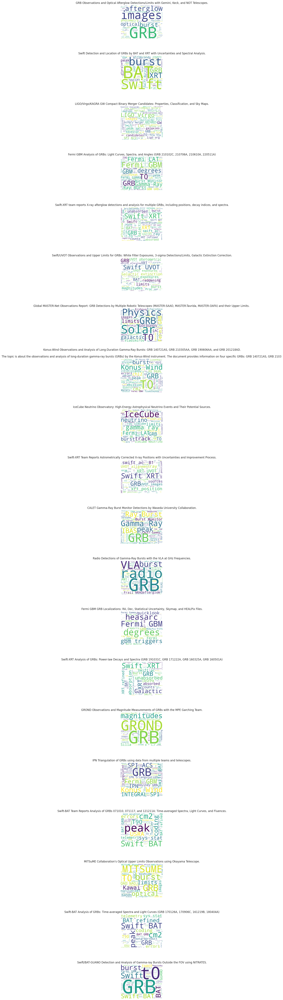

In [25]:
'''
Create word cloud over top 10 topics
'''

fig, axs = plt.subplots(20, 1, figsize=(10, 80)) # Create a figure with 10 subplots vertically arranged

# Join all documents of a topic together and generate word cloud
for topic_num, ax in enumerate(axs):
    word_cloud = WordCloud(
        collocations=True,
        background_color='white',
        max_words=100,
        width=1000,
        height=800,
        stopwords=new_stop_words).generate(' '.join([text for i, text in enumerate(circular_bodies) if topics[i] == topic_num]))

    ax.imshow(word_cloud, interpolation='bilinear')
    ax.set_title(topic_model.topic_representations_[topic_num][0][0])
    ax.axis("off")

plt.subplots_adjust(hspace=0.5)
plt.show()

#Step 10: Trend Analysis

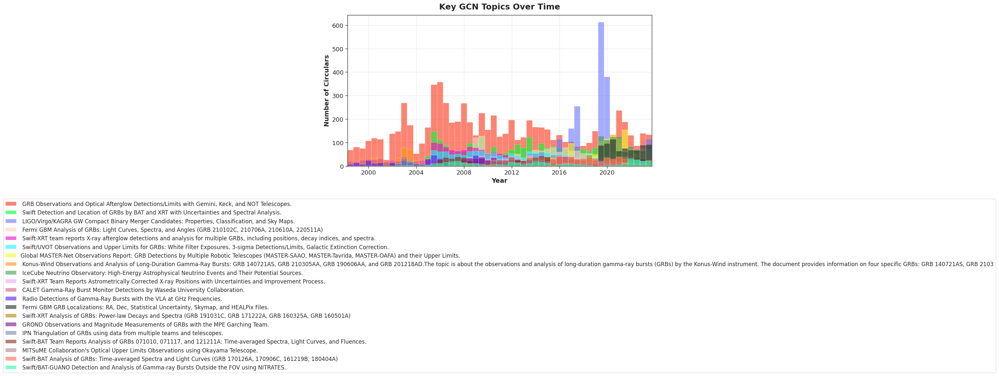

In [26]:
'''
We will now perform Trend Analysis over the topic clusters.
'''
num_topics = len(freq) - 1  # Subtract 1 to exclude outlier row

sns.set_style("whitegrid")
sns.set_style("ticks")
sns.set_context("paper", font_scale=1.5)

light24 = px.colors.qualitative.Light24
dark24 = px.colors.qualitative.Dark24
colors = light24[0:11] + [dark24[9]] + dark24[5:8] + dark24[15:17] + [dark24[13]] + [light24[22]] + [light24[17]]
color_cycle = itertools.cycle(colors)

fig, ax = plt.subplots(figsize=(12, 6))

for k in range(num_topics):
    topic_dates = []  # List to store dates for topic k
    all_dates = []  # List to store all dates

    # Iterate over all timestamps and check their respective document's topic
    # If topic matches k, append its timestamp (as DateTime object) to topic_dates
    for i, time_stamp in enumerate(time_stamps):
        if time_stamp == 0:  # Discard invalid dates
            continue
        if topics[i] == k:
            topic_dates.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Append datetime object to topic_dates
        all_dates.append(datetime.utcfromtimestamp(time_stamp / 1000))

    my_bins = pd.date_range(start=min(all_dates), end=max(all_dates), freq='6M')

    # Iterate through each topic in our topic_dates dict and create histogram
    sns.histplot(topic_dates,
                 bins=mdates.date2num(my_bins),
                 alpha=0.6,
                 linewidth=0.2,
                 color=next(color_cycle),
                 ax=ax,
                 label=topic_model.topic_representations_[k][0][0].replace('\n', ''))

# Calculate the number of 6-month intervals between start and end dates
start_date = min(all_dates)
end_date = max(all_dates)
num_intervals = (end_date.year - start_date.year) * 2 + (end_date.month - start_date.month) // 6

# Calculate the adjusted end date based on the number of intervals
adjusted_end_date = start_date + pd.DateOffset(months=num_intervals * 6)

plt.xlim(start_date, adjusted_end_date)
plt.gca().xaxis.set_major_locator(mdates.YearLocator(4))
plt.xlabel("Year", fontsize=14, fontweight="bold")
plt.ylabel("Number of Circulars", fontsize=14, fontweight="bold")
plt.title("Key GCN Topics Over Time", fontsize=18, fontweight="bold", y=1.02)
plt.grid(axis="both", linestyle="-", alpha=0.5)
plt.legend(bbox_to_anchor=(0.5, -0.2), loc='upper center', fontsize=12)

plt.tight_layout()
plt.show()

# fig, axes = plt.subplots(num_topics, 1, figsize=(18, 6 * num_topics), sharex=True)

# for k in range(num_topics):
#     ax = axes[k]
#     topic_dates = []  # List to store dates for topic k
#     all_dates = []  # List to store all dates

#     # Iterate over all timestamps and check their respective document's topic
#     # If topic matches k, append its timestamp (as DateTime object) to topic_dates
#     for i, time_stamp in enumerate(time_stamps):
#         if time_stamp == 0:  # Discard invalid dates
#             continue
#         if topics[i] == k:
#             topic_dates.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Append datetime object to topic_dates
#         all_dates.append(datetime.utcfromtimestamp(time_stamp / 1000))

#     my_bins = pd.date_range(start=min(all_dates), end=max(all_dates), freq='6M')

#     # Create histogram for the topic
#     sns.histplot(topic_dates,
#                  bins=mdates.date2num(my_bins),
#                  alpha=1.0,
#                  linewidth=0.2,
#                  color=next(color_cycle),
#                  ax=ax)

#     # Calculate the number of 6-month intervals between start and end dates
#     start_date = min(all_dates)
#     end_date = max(all_dates)
#     num_intervals = (end_date.year - start_date.year) * 2 + (end_date.month - start_date.month) // 6

#     # Calculate the adjusted end date based on the number of intervals
#     adjusted_end_date = start_date + pd.DateOffset(months=num_intervals * 6)

#     ax.set_xlim(start_date, adjusted_end_date)
#     ax.xaxis.set_major_locator(mdates.YearLocator(2))
#     ax.set_xlabel("Year", fontsize=14, fontweight="bold")
#     ax.set_ylabel("Number of Circulars", fontsize=14, fontweight="bold")
#     ax.set_title(topic_model.topic_representations_[k][0][0], fontsize=18, fontweight="bold", y=1.02)
#     ax.grid(axis="both", linestyle="-")

# plt.tight_layout()
# plt.show()

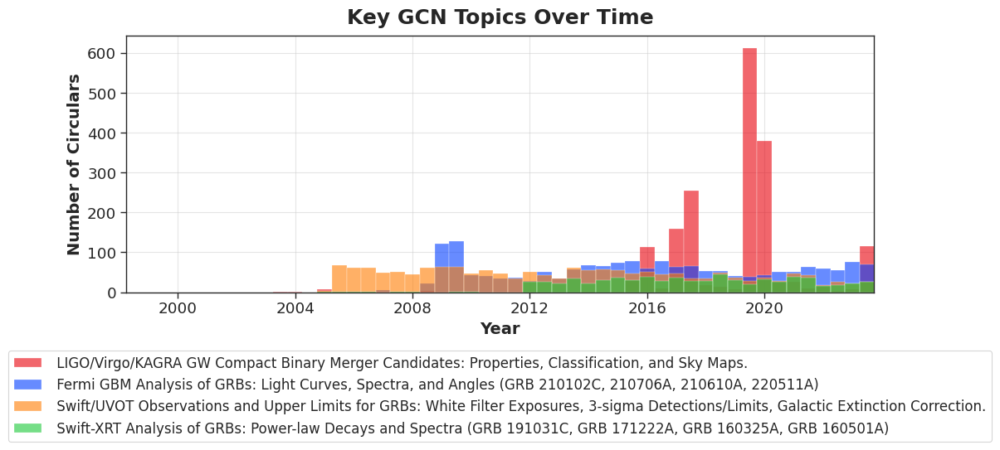

In [27]:
'''
Get histogram for some key topics
'''

num_topics = len(freq) - 1  # Subtract 1 to exclude outlier row
important_topics_list = [2, 3, 5, 13]

sns.set_style("whitegrid")
sns.set_style("ticks")
sns.set_context("paper", font_scale=1.5)
custom_colors = ['#e8000b', '#023eff', '#ff7c00', '#1ac938', '#8b2be2']
custom_palette =  sns.color_palette(custom_colors)

fig, ax = plt.subplots(figsize=(12, 6))

for j, k in enumerate(important_topics_list):
    topic_dates = []  # List to store dates for topic k
    all_dates = []  # List to store all dates

    # Iterate over all timestamps and check their respective document's topic
    # If topic matches k, append its timestamp (as DateTime object) to topic_dates
    for i, time_stamp in enumerate(time_stamps):
        if time_stamp == 0:  # Discard invalid dates
            continue
        if topics[i] == k:
            topic_dates.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Append datetime object to topic_dates
        all_dates.append(datetime.utcfromtimestamp(time_stamp / 1000))

    my_bins = pd.date_range(start=min(all_dates), end=max(all_dates), freq='6M')

    # Iterate through each topic in our topic_dates dict and create histogram
    sns.histplot(topic_dates,
                 bins=mdates.date2num(my_bins),
                 alpha=0.6,
                 linewidth=0.2,
                 color=custom_palette[j],
                 ax=ax,
                 label=topic_model.topic_representations_[k][0][0])

# Calculate the number of 6-month intervals between start and end dates
start_date = min(all_dates)
end_date = max(all_dates)
num_intervals = (end_date.year - start_date.year) * 2 + (end_date.month - start_date.month) // 6

# Calculate the adjusted end date based on the number of intervals
adjusted_end_date = start_date + pd.DateOffset(months=num_intervals * 6)

plt.xlim(start_date, adjusted_end_date)
plt.gca().xaxis.set_major_locator(mdates.YearLocator(4))
plt.xlabel("Year", fontsize=14, fontweight="bold")
plt.ylabel("Number of Circulars", fontsize=14, fontweight="bold")
plt.title("Key GCN Topics Over Time", fontsize=18, fontweight="bold", y=1.02)
plt.grid(axis="both", linestyle="-", alpha=0.5)
plt.legend(bbox_to_anchor=(0.5, -0.2), loc='upper center', fontsize=12)

plt.tight_layout()
plt.show()

#Step 11: Zero-Shot Topic Modelling for Predefined Topics

In [ ]:
'''
We'll now perform topic modelling again but with Zero-Shot enabled.
We will use our fine-tuned all-MiniLM-L6-v2 model for this which was tuned for 2 epochs.
We attempt to fit our topics into pre-defined candidate labels using zero-shot topic modelling.
'''
candidate_topics = ["High Energy Observations",
                    "Optical Observations",
                    "Radio Observations",
                    "Neutrinos",
                    "Gravitational Wave"]

umap_model = UMAP(n_neighbors=15,
                  n_components=5,
                  min_dist=0.0,
                  metric='cosine',
                  low_memory=False,
                  random_state=0)

# Build Topic Model with BERTopic
topic_model = BERTopic(verbose=True,
                       embedding_model=model_2,
                       umap_model=umap_model,
                       min_topic_size=100,
                       vectorizer_model=vectorizer_model,
                       zeroshot_topic_list=candidate_topics,
                       zeroshot_min_similarity=0.01)

topics, probs = topic_model.fit_transform(circular_bodies, tuned_embeddings_2)
topic_labels = [value for key, value in topic_model.topic_labels_.items()]
topic_model.set_topic_labels(topic_labels)

# Display top 10 topics
freq = topic_model.get_topic_info()
freq.head(10)

2024-06-24 20:52:59,241 - BERTopic - Zeroshot Step 1 - Finding documents that could be assigned to either one of the zero-shot topics
2024-06-24 20:52:59,595 - BERTopic - Zeroshot Step 2 - Clustering documents that were not found in the zero-shot model...
2024-06-24 20:52:59,614 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-24 20:52:59,616 - BERTopic - Dimensionality - Completed ✓
2024-06-24 20:52:59,686 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-24 20:52:59,699 - BERTopic - Cluster - Completed ✓
2024-06-24 20:52:59,709 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-24 20:53:05,744 - BERTopic - Representation - Completed ✓
2024-06-24 20:53:06,171 - BERTopic - Zeroshot Step 2 - Completed ✓
2024-06-24 20:53:06,172 - BERTopic - Zeroshot Step 3 - Combining clustered topics with the zeroshot model


,Topic,Count,Name,CustomName,Representation,Representative_Docs
0,0,16445,High Energy Observations,High Energy Observations,"[swift, grb, bat, xrt, gbm, burst, fermi, t0, ...",[GRB 200303A: Fermi GBM observationC. Malacari...
1,1,16375,Optical Observations,Optical Observations,"[grb, optical, afterglow, swift, images, uvot,...",[GRB 131229A: Swift/UVOT Upper LimitsM. De Pas...
2,2,1251,Radio Observations,Radio Observations,"[radio, vla, grb, nrao, ami, frail, afterglow,...",[GRB 060418: Radio ObservationsA. M. Soderberg...
3,3,1024,Neutrinos,Neutrinos,"[icecube, neutrino, events, antares, track, mu...",[IceCube-200929A: Upper limits from a search f...
4,4,375,Gravitational Wave,Gravitational Wave,"[ligo, virgo, compact, bayestar, fits, gracedb...",[LIGO/Virgo/KAGRA S230904n: Identification of ...


In [ ]:
'''
Apply UMAP to reduce the dimensionality of the embeddings and visualize the clusters.
'''

reduced_embeddings = UMAP(n_components=2, random_state=0).fit_transform(tuned_embeddings_2)

fig = go.Figure()
umap_df = pd.DataFrame()
umap_df["x"], umap_df["y"] = reduced_embeddings[:, 0], reduced_embeddings[:, 1]
umap_df["topics"] = [topic_model.topic_labels_[i] for i in topics]

for label in list(topic_model.topic_labels_.values()):
  sub_df = umap_df.loc[umap_df["topics"] == label]
  fig.add_trace(
    go.Scattergl(
      x=sub_df["x"],
      y=sub_df["y"],
      mode="markers",
      name=str(label[label.find('_')+1:]) + " (" + str(sub_df.shape[0]) + ")",
    )
  )

fig.update_traces(
  marker=dict(
    size=5,
    opacity=0.5,
  )
)

fig.update_layout(
  title={
    'text': "<b>General Coordinates Network (GCN): Observation-Based Topic Clusters</b>",
    'x': 0.5,
    'xanchor': 'center'
  },
  width=1200,
  height=800,
  legend_title_text="Topics (Circular Counts)",
  legend=dict(
    x=1.05,
    y=1,
    traceorder='normal',
    bgcolor='rgba(0,0,0,0)',
    bordercolor='rgba(0,0,0,0)'
  ),
  xaxis=dict(
    showticklabels=False
  ),
  yaxis=dict(
    showticklabels=False
  )
)

In [ ]:
'''
Visualise topics in a 2-D space using UMAP
'''

topic_model.visualize_topics()

In [ ]:
fig = topic_model.visualize_barchart(n_words=10, custom_labels=True, height=500, width=500)
fig.show()

In [ ]:
# Display a Similarity Matrix for all Topics
topic_model.visualize_heatmap(width=850, height=650)

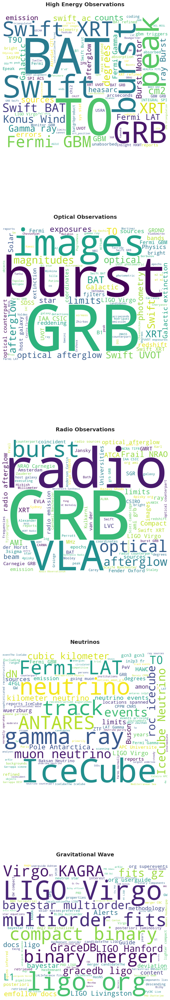

In [ ]:
'''
Create word cloud over our candidate topics
'''

fig, axs = plt.subplots(len(candidate_topics), 1, figsize=(10, 60))

# Join all documents of a candidate topic together and generate word cloud
for topic_num, ax in enumerate(axs):
  word_cloud = WordCloud(
        collocations=True,
        background_color='white',
        max_words=100,
        width=1000,
        height=800,
        stopwords=new_stop_words
    ).generate(' '.join([text for i, text in enumerate(circular_bodies) if topic_model.topic_labels_[topics[i]] == candidate_topics[topic_num]]))

  ax.imshow(word_cloud, interpolation='bilinear')
  ax.set_title(candidate_topics[topic_num], fontsize=18, fontweight="bold", y=1.05)
  ax.axis("off")

plt.subplots_adjust(hspace=0.5)
plt.show()

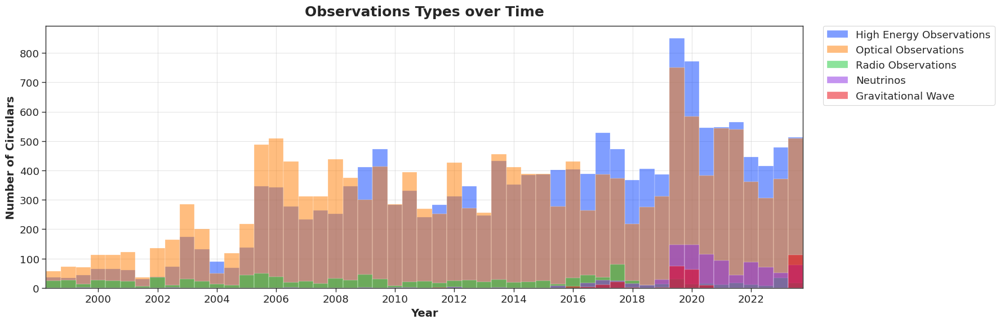

In [ ]:
'''
We will now perform Trend Analysis over our Topic Clusters.
'''

num_topics = len(freq)
sns.set_style("whitegrid")
sns.set_style("ticks")
sns.set_context("paper", font_scale=1.5)
plt.figure(figsize=(18, 6))
custom_colors = ['#023eff', '#ff7c00', '#1ac938', '#8b2be2', '#e8000b']
custom_palette =  sns.color_palette(custom_colors)

for k in range(num_topics):
  topic_dates = [] # List to store dates for topic k
  all_dates = [] # List to store all dates

  # Iterate over all timestamps and check their respective document's topic
  # If topic matches k, append its timestamp (as DateTime object) to topic_dates
  for i, time_stamp in enumerate(time_stamps):
      if time_stamp == 0: # Discard invalid dates
          continue
      if topics[i] == k:
          topic_dates.append(datetime.utcfromtimestamp(time_stamp/1000)) # Append datetime object to topic_dates
      all_dates.append(datetime.utcfromtimestamp(time_stamp/1000))

  my_bins = pd.date_range(start=min(all_dates), end=max(all_dates), freq='6M')

  # Iterate through each topic in our topic_dates dict and create histogram
  sns.histplot(topic_dates,
               bins=mdates.date2num(my_bins),
               alpha=0.5,
               linewidth=0.2,
               color=custom_palette[k],
               label=topic_model.topic_labels_[k])

# Calculate the number of 6-month intervals between start and end dates
start_date = min(all_dates)
end_date = max(all_dates)
num_intervals = (end_date.year - start_date.year) * 2 + (end_date.month - start_date.month) // 6

# Calculate the adjusted end date based on the number of intervals
adjusted_end_date = start_date + pd.DateOffset(months=num_intervals * 6)

plt.xlim(start_date, adjusted_end_date)
plt.gca().xaxis.set_major_locator(mdates.YearLocator(2))
plt.xlabel("Year", fontsize=14, fontweight="bold")
plt.ylabel("Number of Circulars", fontsize=14, fontweight="bold")
plt.title("Observations Types over Time", fontsize=18, fontweight="bold", y=1.02)
plt.grid(axis="both", linestyle="-", alpha=0.5)
plt.legend(bbox_to_anchor=(1.02, 1.02), loc='upper left')

plt.tight_layout()
plt.show()